In [ ]:
# This cell is used to change parameter of the rise slideshow, 
# such as the window width/height and enabling a scroll bar

from notebook.services.config import ConfigManager
cm = ConfigManager()
cm.update('livereveal', {
              'width': 1500,
              'height': 300,
              'scroll': True,
})

# DATA WRANGLING (OR HOW I STOPPED USING EXCEL FOR EVERYTHING)
![Data Wrangler](https://www.dropbox.com/s/kmgw2klhnubo9zs/Data-Wrangler-Gaucho.png?raw=1)

# When Spreadsheets Attack!!!

In [1]:
from IPython.display import HTML
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/yb2zkxHDfUE" frameborder="0" allow="accelerometer; autoplay; encrypted-media; gyroscope; picture-in-picture" allowfullscreen></iframe>')

/Users/ian/opt/anaconda3/lib/python3.7/site-packages/IPython/core/display.py:694: UserWarning: Consider using IPython.display.IFrame instead
  warnings.warn("Consider using IPython.display.IFrame instead")


# Key Highlights

* Spreadsheets are interactive, but error-prone (costing millions)

* There is a thing called European Spreadsheet Risk Interest Group (EuSpRiG), and they have a [horror stories](http://www.eusprig.org/horror-stories.htm) website!

* A researcher was able to get 15k spreadsheets from Enron, and found that 42% didn't have a single formula/calculation!

* From the remaining 9k, 24% contained "obvious" errors!

* Excel assumes formats when typing, and autocorrections creates chaos

* Excel has finite rows/cols (big data?)

## EVEN MICROSOFT STATES THAT THEIR PRODUCT IS FOR MOST DAY TO DAY SCENARIOS!

## BUT ARE YOU IN ONE OF THOSE?

# Importing and working with data in Python

Data can be imported from `.xlsx`, `.txt`, `.csv`, `.tsv` or any other tabular format using `pandas`, which is a package that you can **import** with a single line of code:

![text.csv](https://www.dropbox.com/s/c4xz93t3e35zjvg/textcsv.png?raw=1)

Compared to Excel, Pandas have much more formats and are capable of importing data into more "data science" related ones. 

In [2]:
import pandas as pd
test = pd.read_csv('test.csv')
test

Matplotlib is building the font cache using fc-list. This may take a moment.


FileNotFoundError: [Errno 2] File b'test.csv' does not exist: b'test.csv'

In [ ]:
## Printing the type of each column using the "dtype" attribute
print(test['Name'].dtype)
print(test['Sort Code'].dtype)
print(test['Savings'].dtype)

We can import the `Savings` column as an object, a string or even a hexadecimal number!

In [ ]:
from functools import partial

savings = pd.read_csv('test.csv',  usecols=['Savings'], converters={'Savings': partial(int, base=16)})
test['Hex'] = savings['Savings'].apply(hex)
test

We can also convert the `Sort Code` into a date

In [ ]:
sortcode = pd.read_csv('test.csv',  usecols=['Sort Code'])
test['Date']=sortcode.apply(pd.to_datetime)
test

# Importing data from cities

For today's tutorial, we will use a file called `city_populations.txt` which you can download from [here](https://gist.githubusercontent.com/johnburnmurdoch/4199dbe55095c3e13de8d5b2e5e5307a/raw/fa018b25c24b7b5f47fd0568937ff6c04e384786/city_populations)

This file contains population data of different world cities through time

You can read a file using `pd.read_csv` (even when the file is not a csv!), storing it in a variable called `df`

In [4]:
df = pd.read_csv('https://gist.githubusercontent.com/johnburnmurdoch/4199dbe55095c3e13de8d5b2e5e5307a/raw/fa018b25c24b7b5f47fd0568937ff6c04e384786/city_populations')
df

,name,group,year,value,subGroup,city_id,lastValue,lat,lon
0,Agra,India,1575,200.0,India,Agra - India,200.0,27.18333,78.01667
1,Agra,India,1576,212.0,India,Agra - India,200.0,27.18333,78.01667
2,Agra,India,1577,224.0,India,Agra - India,212.0,27.18333,78.01667
3,Agra,India,1578,236.0,India,Agra - India,224.0,27.18333,78.01667
4,Agra,India,1579,248.0,India,Agra - India,236.0,27.18333,78.01667
...,...,...,...,...,...,...,...,...,...
6247,Vijayanagar,India,1561,480.0,India,Vijayanagar - India,480.0,15.33500,76.46200
6248,Vijayanagar,India,1562,480.0,India,Vijayanagar - India,480.0,15.33500,76.46200
6249,Vijayanagar,India,1563,480.0,India,Vijayanagar - India,480.0,15.33500,76.46200
6250,Vijayanagar,India,1564,480.0,India,Vijayanagar - India,480.0,15.33500,76.46200


# Exploring the data

You can show the top $n$ entries of the data frame using the `head` option:

In [5]:
df.head(6)

,name,group,year,value,subGroup,city_id,lastValue,lat,lon
0,Agra,India,1575,200.0,India,Agra - India,200.0,27.18333,78.01667
1,Agra,India,1576,212.0,India,Agra - India,200.0,27.18333,78.01667
2,Agra,India,1577,224.0,India,Agra - India,212.0,27.18333,78.01667
3,Agra,India,1578,236.0,India,Agra - India,224.0,27.18333,78.01667
4,Agra,India,1579,248.0,India,Agra - India,236.0,27.18333,78.01667
5,Agra,India,1580,260.0,India,Agra - India,248.0,27.18333,78.01667


You can also show the entries of a certain city/group/value, etc.

In [6]:
# Get the 90th entrie in the dataset
df.loc[90]

name                 Ahmedabad
group                    India
year                      1598
value                      185
subGroup                 India
city_id      Ahmedabad - India
lastValue                182.5
lat                    23.0396
lon                     72.566
Name: 90, dtype: object

In [11]:
# you can use the set function to see one of each value in the name column
print(set(df['name']))

{'Ayutthaya', 'Agra', 'Nanjing', 'Delhi', 'Gauda', 'Mashhad', 'Los Angeles', 'Boston', 'Edirne', 'Guangzhou', 'Buenos Aires', 'Chicago', 'Istanbul', 'Naples', 'Seoul', 'Moscow', 'Suzhou', 'Hangzhou', 'Sao Paulo', 'Tabriz', 'Kolkatta', 'Berlin', 'Rio de Janeiro', 'Venice', 'Pegu', 'Amsterdam', 'Birmingham', 'Kyoto', 'Osaka', 'Mexico City', 'Bijapur', 'Lisbon', 'Esfahan', 'Vienna', 'Lucknow', 'Mumbai', 'Manchester', 'Tokyo', 'Ahmedabad', 'Saint Petersburg', 'Paris', 'Shanghai', 'Philadelphia', 'Cairo', 'London', 'Karachi', 'Dhaka', 'Vijayanagar', 'Beijing', 'New York', 'Fez', 'Cuttack'}


# Wrangling the data

Notice that not all columns are of interest in case that we want to analyse the population throughout the time

For instance, we can get rid of the `subGroup`, `city_id`, `last_value`, `longitude` and `latitude`

In [12]:
df = df[['name','group','year','value']]
df

,name,group,year,value
0,Agra,India,1575,200.0
1,Agra,India,1576,212.0
2,Agra,India,1577,224.0
3,Agra,India,1578,236.0
4,Agra,India,1579,248.0
...,...,...,...,...
6247,Vijayanagar,India,1561,480.0
6248,Vijayanagar,India,1562,480.0
6249,Vijayanagar,India,1563,480.0
6250,Vijayanagar,India,1564,480.0


We will change the names of the columns to something more informative!

In [13]:
df = df.rename(columns={"name": "city", "group": "continent", "value":"population"})
df

,city,continent,year,population
0,Agra,India,1575,200.0
1,Agra,India,1576,212.0
2,Agra,India,1577,224.0
3,Agra,India,1578,236.0
4,Agra,India,1579,248.0
...,...,...,...,...
6247,Vijayanagar,India,1561,480.0
6248,Vijayanagar,India,1562,480.0
6249,Vijayanagar,India,1563,480.0
6250,Vijayanagar,India,1564,480.0


Notice that in the `continent` column we have India for some cities

If I'm correct, India is a sub-continent rather than a continent!

We can replace this value in all rows with a simple command

First, let's see all values that are contained in the `continent` column

In [14]:
# You can use the set instruction to see only one value of each
set(df['continent'])

{'Asia', 'Europe', 'India', 'Latin America', 'Middle East', 'North America'}

We can also check which cities are in `India` and `Middle East`

In [15]:
# Cities with "continent" India
print(set(df[df['continent']=='India']['city']))

{'Kolkatta', 'Agra', 'Delhi', 'Gauda', 'Bijapur', 'Vijayanagar', 'Lucknow', 'Mumbai', 'Ahmedabad', 'Cuttack'}


In [16]:
# Cities with "continent" Middle east
print(set(df[df['continent']=='Middle East']['city']))

{'Cairo', 'Mashhad', 'Esfahan', 'Fez', 'Tabriz'}


Let's first replace `India -> Asia`

In [17]:
df['continent'] = df['continent'].replace('India', 'Asia')

Now we can check if the changes have been successful by creating sub-data frames!

In [18]:
df_asia = df[df['continent']=='Asia']
df_asia

,city,continent,year,population
0,Agra,Asia,1575,200.0
1,Agra,Asia,1576,212.0
2,Agra,Asia,1577,224.0
3,Agra,Asia,1578,236.0
4,Agra,Asia,1579,248.0
...,...,...,...,...
6247,Vijayanagar,Asia,1561,480.0
6248,Vijayanagar,Asia,1562,480.0
6249,Vijayanagar,Asia,1563,480.0
6250,Vijayanagar,Asia,1564,480.0


Moreover, notice that this dataset also contains `Latin America` as a continent

We can see which countries are listed as Latin American using `set` plus a condition

In [19]:
# Set up the condition that the continent should be Latin America
our_condition = df['continent']=='Latin America'
# Print all Latin American Countries
print(set(df[our_condition]['city']))

{'Buenos Aires', 'Rio de Janeiro', 'Sao Paulo', 'Mexico City'}


I know for a fact that `Mexico City` is in `North America`, while `Buenos Aires`, `Sao Paulo` and `Rio de Janeiro` are in `South America`!

Moreover, in the `Middle East` "continent" we have two cities from `Africa` (`Fez` and `Cairo`) and three from `Asia` (`Mashhad`, `Tabriz` and `Esfahan`).

How can I replace correctly these values?

In [20]:
## First, replacing the continent value for the entries of Cairo and Fez
# First, establish the condition
our_condition = df['city']=='Fez'
# Then replace all values ONLY for the given condition
df['continent'][our_condition]='Africa'
# Show that the relacement has been successful
df[df['city']=='Fez']

/Users/ian/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,city,continent,year,population
1496,Fez,Africa,1500,130.000000
1497,Fez,Africa,1501,130.076923
1498,Fez,Africa,1502,130.153846
1499,Fez,Africa,1503,130.230769
1500,Fez,Africa,1504,130.307692
1501,Fez,Africa,1505,130.384615
1502,Fez,Africa,1506,130.461538


In [21]:
## First, replacing the continent value for the entries of Cairo and Fez
# First, establish the condition
our_condition = df['city']=='Cairo'
# Then replace all values ONLY for the given condition
df['continent'][our_condition]='Africa'
# Show that the relacement has been successful
df[df['city']=='Cairo']

/Users/ian/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,city,continent,year,population
1055,Cairo,Africa,1500,400.0
1056,Cairo,Africa,1501,399.2
1057,Cairo,Africa,1502,398.4
1058,Cairo,Africa,1503,397.6
1059,Cairo,Africa,1504,396.8
...,...,...,...,...
1193,Cairo,Africa,2016,19131.2
1194,Cairo,Africa,2017,19490.4
1195,Cairo,Africa,2018,19849.6
1196,Cairo,Africa,2019,20208.8


Now we can replace all the remaining values for the other three cities

In [22]:
df['continent'] = df['continent'].replace('Middle East', 'Asia')

In [23]:
# Chcking if Mashhad (Iran) has changed from Middle East to Asia
df_mashhad = df[df['city']=='Mashhad']
df_mashhad

,city,continent,year,population
3455,Mashhad,Asia,1696,210.814815
3456,Mashhad,Asia,1697,212.888889
3457,Mashhad,Asia,1698,214.962963
3458,Mashhad,Asia,1699,217.037037
3459,Mashhad,Asia,1700,219.111111
3460,Mashhad,Asia,1701,221.185185
3461,Mashhad,Asia,1702,223.259259
3462,Mashhad,Asia,1703,225.333333
3463,Mashhad,Asia,1704,227.407407
3464,Mashhad,Asia,1705,229.481481


Same for the `Latin America` case

In [24]:
## Replacing the continent value for the entries of Mexico City
# First, establish the condition
our_condition = df['city']=='Mexico City'
# Then replace all values ONLY for the given condition
df['continent'][our_condition]='North America'
# Show that the relacement has been successful
df[df['city']=='Mexico City']

/Users/ian/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """


,city,continent,year,population
3508,Mexico City,North America,1952,3736.6
3509,Mexico City,North America,1953,3922.4
3510,Mexico City,North America,1954,4108.2
3511,Mexico City,North America,1955,4294.0
3512,Mexico City,North America,1956,4531.0
...,...,...,...,...
3572,Mexico City,North America,2016,21172.8
3573,Mexico City,North America,2017,21346.6
3574,Mexico City,North America,2018,21520.4
3575,Mexico City,North America,2019,21694.2


Now we can replace all the remaining values for the other three cities

In [25]:
df['continent'] = df['continent'].replace('Latin America', 'South America')

In [26]:
df[df['city']=='Buenos Aires']

,city,continent,year,population
957,Buenos Aires,South America,1911,1453.428571
958,Buenos Aires,South America,1912,1512.285714
959,Buenos Aires,South America,1913,1571.142857
960,Buenos Aires,South America,1914,1630.000000
961,Buenos Aires,South America,1915,1700.909091
...,...,...,...,...
1050,Buenos Aires,South America,2004,13145.400000
1051,Buenos Aires,South America,2005,13330.000000
1052,Buenos Aires,South America,2006,13513.200000
1053,Buenos Aires,South America,2007,13696.400000


In [27]:
df[df['city']=='Sao Paulo']

,city,continent,year,population
5395,Sao Paulo,South America,1968,6769.6
5396,Sao Paulo,South America,1969,7194.8
5397,Sao Paulo,South America,1970,7620.0
5398,Sao Paulo,South America,1971,8018.8
5399,Sao Paulo,South America,1972,8417.6
5400,Sao Paulo,South America,1973,8816.4
5401,Sao Paulo,South America,1974,9215.2
5402,Sao Paulo,South America,1975,9614.0
5403,Sao Paulo,South America,1976,10109.0
5404,Sao Paulo,South America,1977,10604.0


In [28]:
df[df['city']=='Rio de Janeiro']

,city,continent,year,population
5270,Rio de Janeiro,South America,1971,7260.0
5271,Rio de Janeiro,South America,1972,7520.0
5272,Rio de Janeiro,South America,1973,7780.0
5273,Rio de Janeiro,South America,1974,8040.0
5274,Rio de Janeiro,South America,1975,8300.0
5275,Rio de Janeiro,South America,1976,8396.8
5276,Rio de Janeiro,South America,1977,8493.6
5277,Rio de Janeiro,South America,1978,8590.4
5278,Rio de Janeiro,South America,1979,8687.2
5279,Rio de Janeiro,South America,1980,8784.0


Saving the dataset

In [29]:
df.to_csv(r'city_populations_updated.csv',index=False)

# Creating a Bar Chart Race

Surely you have seen these ones before!

![gif](https://www.dropbox.com/s/fyrnrpkani0g0dg/barchartrace.gif?raw=1)

Let's try to do our own bar chart race in `Python` and the `matplotlib` package!

In [30]:
# Importing the necessary packages
import matplotlib.pyplot as plt
import matplotlib.ticker as ticker
# This helps that charts appear in the notebook
%matplotlib inline 

If we just plot **city vs population** using `ax.barh`, we will see the last value of population for each of the cities.

<BarContainer object of 6252 artists>

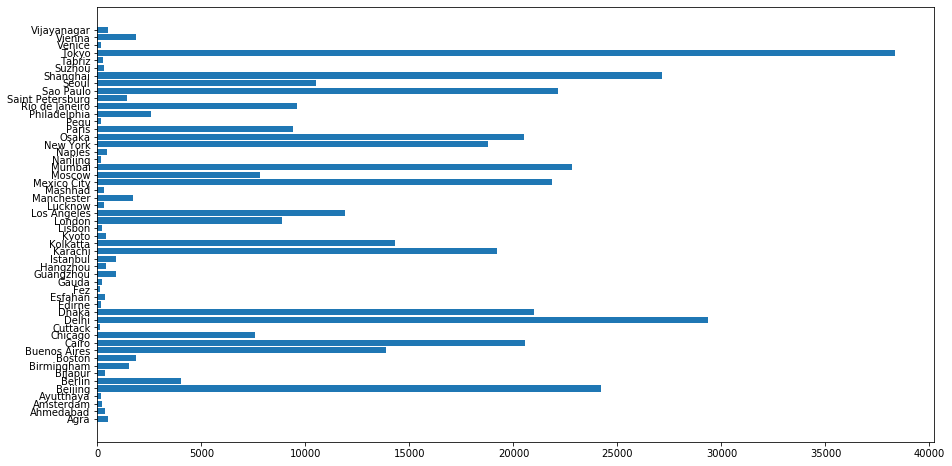

In [31]:
fig, ax = plt.subplots(figsize=(15, 8))
ax.barh(df['city'], df['population'])

To do a bar chart race, we need to define a given year and sort the cities from most to least populated (for that year)

In [32]:
current_year = 2000
df2 = (df[df['year'].eq(current_year)]
       .sort_values(by='population',ascending=False))
df2

,city,continent,year,population
6027,Tokyo,Asia,2000,34450.0
4661,Osaka,Asia,2000,18660.0
3556,Mexico City,North America,2000,18457.0
4309,New York,North America,2000,17813.0
5427,Sao Paulo,South America,2000,17014.0
3730,Mumbai,Asia,2000,16367.0
1306,Delhi,Asia,2000,15732.0
5529,Shanghai,Asia,2000,13959.0
1177,Cairo,Africa,2000,13626.0
2614,Kolkatta,Asia,2000,13058.0


Notice that in this dataset, we don't have all cities for each year so we would get different charts

<BarContainer object of 12 artists>

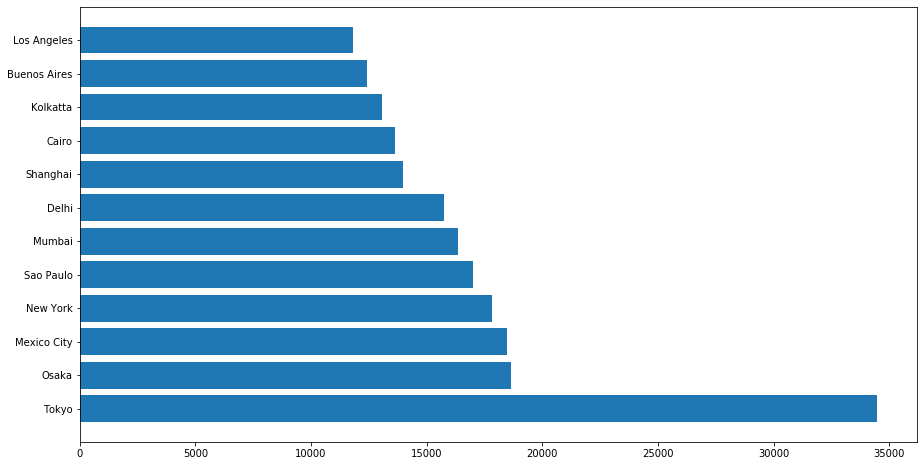

In [33]:
# Plotting a basic bar chart
fig, ax = plt.subplots(figsize=(15, 8))
ax.barh(df2['city'], df2['population'])

## Adding colour and labels

In [50]:
colors = dict(zip(
    ['Europe', 'Asia', 'South America', 'North America', 'Africa'],
    ["#009E73", "#F0E442", "#0072B2", "#D55E00", "#CC79A7"]))
group_lk = df.set_index('city')['continent'].to_dict()
group_lk

{'Agra': 'Asia',
 'Ahmedabad': 'Asia',
 'Amsterdam': 'Europe',
 'Ayutthaya': 'Asia',
 'Beijing': 'Asia',
 'Berlin': 'Europe',
 'Bijapur': 'Asia',
 'Birmingham': 'Europe',
 'Boston': 'North America',
 'Buenos Aires': 'South America',
 'Cairo': 'Africa',
 'Chicago': 'North America',
 'Cuttack': 'Asia',
 'Delhi': 'Asia',
 'Dhaka': 'Asia',
 'Edirne': 'Europe',
 'Esfahan': 'Asia',
 'Fez': 'Africa',
 'Gauda': 'Asia',
 'Guangzhou': 'Asia',
 'Hangzhou': 'Asia',
 'Istanbul': 'Europe',
 'Karachi': 'Asia',
 'Kolkatta': 'Asia',
 'Kyoto': 'Asia',
 'Lisbon': 'Europe',
 'London': 'Europe',
 'Los Angeles': 'North America',
 'Lucknow': 'Asia',
 'Manchester': 'Europe',
 'Mashhad': 'Asia',
 'Mexico City': 'North America',
 'Moscow': 'Europe',
 'Mumbai': 'Asia',
 'Nanjing': 'Asia',
 'Naples': 'Europe',
 'New York': 'North America',
 'Osaka': 'Asia',
 'Paris': 'Europe',
 'Pegu': 'Asia',
 'Philadelphia': 'North America',
 'Rio de Janeiro': 'South America',
 'Saint Petersburg': 'Europe',
 'Sao Paulo': 'South

Now we can use this pairing to get some colours in `df2`

Text(1, 0.4, '2000')

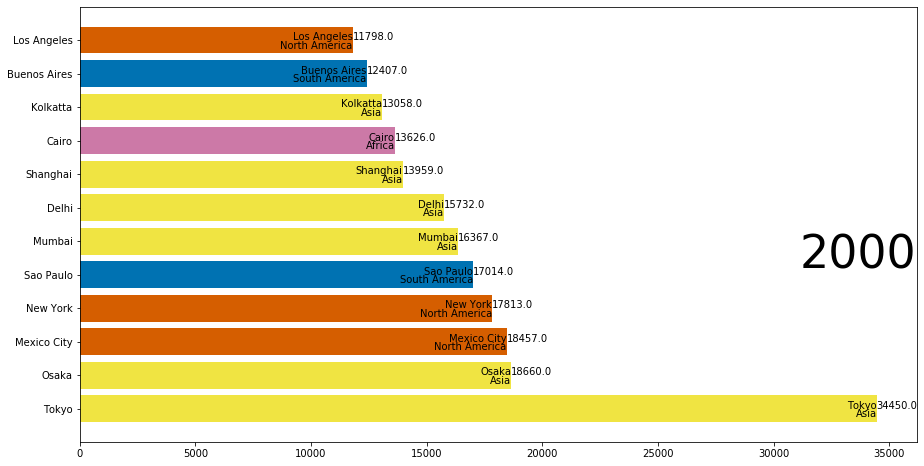

In [51]:
fig, ax = plt.subplots(figsize=(15, 8))
df2 = df2[::-1]   # flip values from top to bottom
# pass colours values to `color=`
ax.barh(df2['city'], df2['population'], color=[colors[group_lk[x]] for x in df2['city']])
# iterate over the values to plot labels and values (Tokyo, Asia, 38194.2)
for i, (value, name) in enumerate(zip(df2['population'], df2['city'])):
    ax.text(value, i,     name,            ha='right')
    ax.text(value, i-.25, group_lk[name],  ha='right')
    ax.text(value, i,     value,           ha='left')
# Add year right middle portion of canvas
ax.text(1, 0.4, current_year, transform=ax.transAxes, size=46, ha='right')

## Styling the chart

This function will draw a more "stylish" function to create the last chart

In [67]:
def draw_barchart(year):
    dff = df[df['year'].eq(year)].sort_values(by='population', ascending=True).tail(20)
    ax.clear()
    ax.barh(dff['city'], dff['population'], color=[colors[group_lk[x]] for x in dff['city']])
    dx = dff['population'].max() / 200
    for i, (value, name) in enumerate(zip(dff['population'], dff['city'])):
        ax.text(value-dx, i,     name,           size=14, weight=600, ha='right', va='bottom')
        ax.text(value-dx, i-.25, group_lk[name], size=10, color='#444444', ha='right', va='baseline')
        ax.text(value+dx, i,     f'{value:,.0f}',  size=14, ha='left',  va='center')
    # ... polished styles
    ax.text(1, 0.4, year, transform=ax.transAxes, color='#777777', size=46, ha='right', weight=800)
    ax.text(0, 1.06, 'Population (thousands)', transform=ax.transAxes, size=12, color='#777777')
    ax.xaxis.set_major_formatter(ticker.StrMethodFormatter('{x:,.0f}'))
    ax.xaxis.set_ticks_position('top')
    ax.tick_params(axis='x', colors='#777777', labelsize=12)
    ax.set_yticks([])
    ax.margins(0, 0.01)
    ax.grid(which='major', axis='x', linestyle='-')
    ax.set_axisbelow(True)
    ax.text(0, 1.12, 'The most populous cities in the world ',
            transform=ax.transAxes, size=24, weight=600, ha='left')
    plt.box(False)

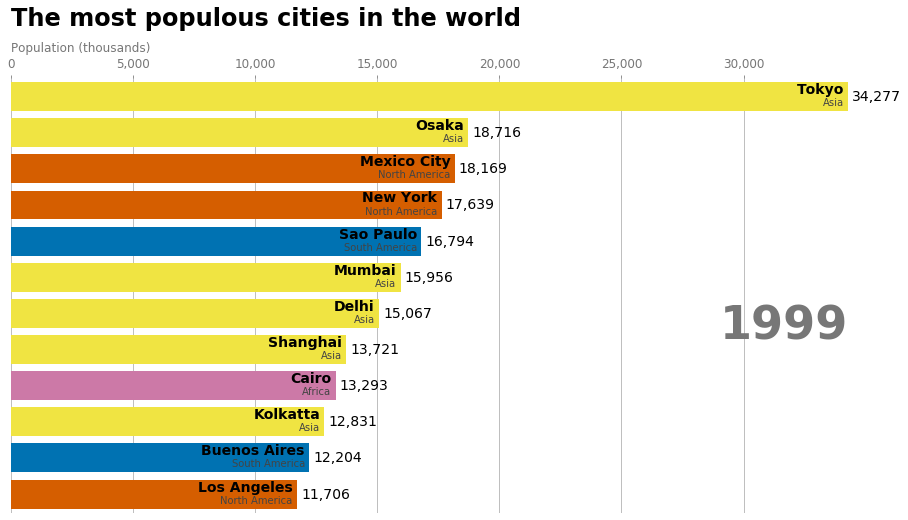

In [72]:
fig, ax = plt.subplots(figsize=(15, 8))
draw_barchart(1999)

In [74]:
# if you get the error message below, run this cell
# "Animation size has reached 20997590 bytes, exceeding the limit of 20971520.0. 
# If you're sure you want a larger animation embedded, set the 
#animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped."

import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128

## Animating the chart

We can import an `animation` module in `matplotlib` which will help us call the `draw_barchart` function for a range of years!

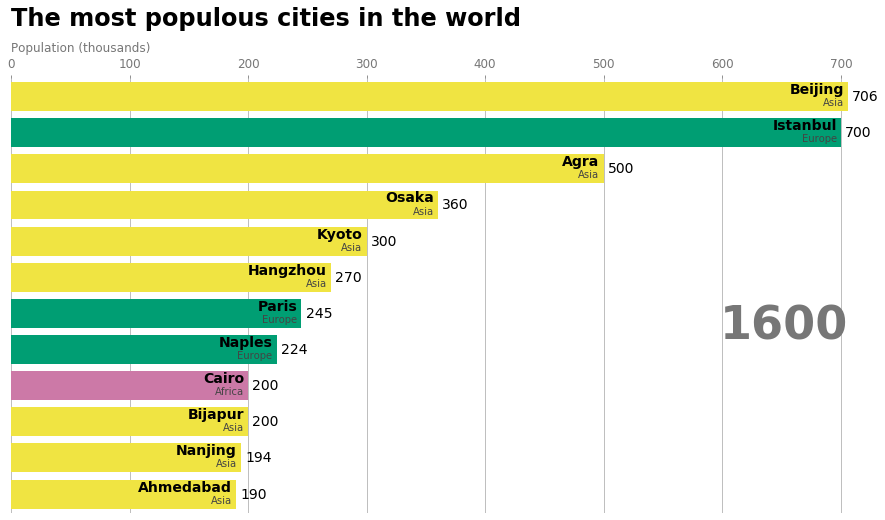

In [73]:
import matplotlib.animation as animation
from IPython.display import HTML

fig, ax = plt.subplots(figsize=(15, 8))
animator = animation.FuncAnimation(fig, draw_barchart, frames=range(1600,2010))
HTML(animator.to_jshtml()) 

# Challenges for the day

Regardless of your level, you will see that there is no need to understand the entire set of code!

* **Beginners**: Download this code and run it, make sure that you are capable of understanding how to wrangle the data and reproduce the bar chart race.

* **Intermediates**: See if you can change colours, styles, names, etc. Can you skip some years? How to get rid of the static plot that gets printed after the animation?

* **Experts**: Can you show not only the top 10 cities? Can you show all cities? Could you put the years of the range in the title of the chart? Can you show the chart from 1500 to 2020? Can you make the chart go back in time?

# By the way...

You can find the original tutorial [here](https://towardsdatascience.com/bar-chart-race-in-python-with-matplotlib-8e687a5c8a41), they have even set up a [Google Colaboratory](https://colab.research.google.com/github/pratapvardhan/notebooks/blob/master/barchart-race-matplotlib.ipynb) jupyter notebook online so that you can see this activity at any time!